In [14]:
import torch
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
import numpy as np
import matplotlib.pyplot as plt
import torchvision.utils as vutils
import torch.optim as optim
import torch.nn as nn

import matplotlib.animation as animation
from IPython.display import HTML

In [15]:
image_folder = "data"
batch_size = 128
image_size = 64
# Number of channels 
nc = 3
# Latent size
nz = 100
# number of feature maps in generator and discriminator
nf = 64
num_epochs = 100
# Learning rate for optimizers
lr = 0.0002
# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5
# Number of GPUs available
ngpu = 1

In [16]:
# Delete files for Mac
!find './data/img_41K' -name "._*" -type f -delete

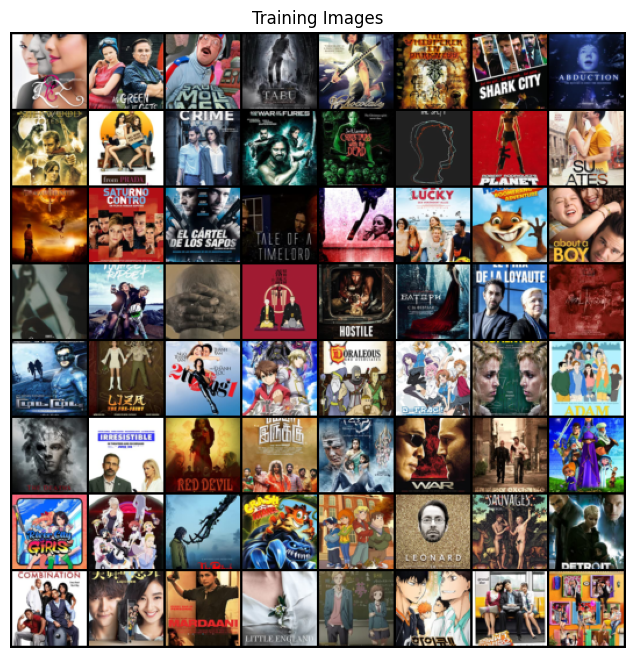

In [17]:
# Transform image
transform = transforms.Compose([
    transforms.Resize(image_size),         # Resize image 
    transforms.CenterCrop(image_size),    # Crop the image at the center
    transforms.ToTensor(),        # Convert the image to a PyTorch tensor
    transforms.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5))    # Normalize the image to have mean and standard deviation of 0.5
])
# Create a dataset from the image folder and apply transformation
data_set = ImageFolder(root=image_folder, transform=transform)
# Load the images in batches
data_loader = DataLoader(data_set, batch_size=batch_size, shuffle=True, num_workers=2)

# Use gpu
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Samples of movie posters
real_batch = next(iter(data_loader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))


In [18]:
# !rm -r "/content/data"

In [19]:
# Check how many data are in the data_loader
num_data = len(data_loader.dataset)
print("Number of data in DataLoader:", num_data)

Number of data in DataLoader: 41979


In [45]:
# Weights initialization for "netG" and "netD"
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [46]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.layers = nn.Sequential(
            # input is (nc)x64x64
            nn.Conv2d(nc,nf,4,2,1,bias=False),
            nn.LeakyReLU(0.2,inplace=True),
            # Size (nf)x32x32
            nn.Conv2d(nf,nf*2,4,2,1,bias=False),
            nn.BatchNorm2d(nf*2),
            nn.LeakyReLU(0.2,inplace=True),
            # Size (nf*2)x16x16
            nn.Conv2d(nf*2,nf*4,4,2,1,bias=False),
            nn.BatchNorm2d(nf*4),
            nn.LeakyReLU(0.2,inplace=True),
            # Size (nf*4)x8x8
            nn.Conv2d(nf*4,nf*8,4,2,1,bias=False),
            nn.BatchNorm2d(nf*8),
            nn.LeakyReLU(0.2,inplace=True),
            # Size (nf*8)x4x4
            nn.Conv2d(nf*8,1,4,1,0,bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.layers(input)

In [47]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (layers): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [48]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.layers = nn.Sequential(
            # input is Z for convolution
            nn.ConvTranspose2d(nz,nf*8,4,1,0,bias=False),
            nn.BatchNorm2d(nf*8),
            nn.ReLU(True),
            # Size (nf*8)x4x4
            nn.ConvTranspose2d(nf*8,nf*4,4,2,1,bias=False),
            nn.BatchNorm2d(nf*4),
            nn.ReLU(True),
            # Size (nf*4)x8x8
            nn.ConvTranspose2d(nf*4,nf*2,4,2,1,bias=False),
            nn.BatchNorm2d(nf*2),
            nn.ReLU(True),
            # Size (nf*2)x16x16
            nn.ConvTranspose2d(nf*2,nf,4,2,1,bias=False),
            nn.BatchNorm2d(nf),
            nn.ReLU(True),
            # Size (nf)x32x32
            nn.ConvTranspose2d(nf,nc,4,2,1,bias=False),
            nn.Tanh()
            # Size (nc)x64x64
        )
        
    def forward(self, input):
        return self.layers(input)

In [49]:
# Create the generator netG
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (layers): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )


In [50]:
# Initialize the BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors for generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [51]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(data_loader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(data_loader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(data_loader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/100][0/328]	Loss_D: 1.4333	Loss_G: 6.5473	D(x): 0.5394	D(G(z)): 0.4402 / 0.0023
[0/100][50/328]	Loss_D: 0.1906	Loss_G: 8.3031	D(x): 0.8677	D(G(z)): 0.0007 / 0.0005
[0/100][100/328]	Loss_D: 0.0759	Loss_G: 6.3894	D(x): 0.9573	D(G(z)): 0.0262 / 0.0019
[0/100][150/328]	Loss_D: 0.5090	Loss_G: 6.1774	D(x): 0.8946	D(G(z)): 0.2864 / 0.0030
[0/100][200/328]	Loss_D: 0.8361	Loss_G: 3.3571	D(x): 0.6045	D(G(z)): 0.0699 / 0.0476
[0/100][250/328]	Loss_D: 0.3532	Loss_G: 6.4931	D(x): 0.7387	D(G(z)): 0.0045 / 0.0024
[0/100][300/328]	Loss_D: 0.4530	Loss_G: 6.6369	D(x): 0.9255	D(G(z)): 0.2844 / 0.0016
[1/100][0/328]	Loss_D: 0.2711	Loss_G: 4.8055	D(x): 0.8567	D(G(z)): 0.0605 / 0.0132
[1/100][50/328]	Loss_D: 0.2589	Loss_G: 4.5085	D(x): 0.9428	D(G(z)): 0.1313 / 0.0303
[1/100][100/328]	Loss_D: 0.3635	Loss_G: 3.7926	D(x): 0.7678	D(G(z)): 0.0567 / 0.0453
[1/100][150/328]	Loss_D: 0.9406	Loss_G: 3.9697	D(x): 0.6654	D(G(z)): 0.2842 / 0.0343
[1/100][200/328]	Loss_D: 0.4816	Loss_G: 2.971

[13/100][300/328]	Loss_D: 0.7427	Loss_G: 1.7113	D(x): 0.5621	D(G(z)): 0.0436 / 0.2496
[14/100][0/328]	Loss_D: 0.8008	Loss_G: 4.9742	D(x): 0.9314	D(G(z)): 0.4218 / 0.0144
[14/100][50/328]	Loss_D: 0.3566	Loss_G: 3.5963	D(x): 0.8318	D(G(z)): 0.1261 / 0.0392
[14/100][100/328]	Loss_D: 0.4072	Loss_G: 3.9386	D(x): 0.7606	D(G(z)): 0.0761 / 0.0354
[14/100][150/328]	Loss_D: 0.3443	Loss_G: 3.6334	D(x): 0.8319	D(G(z)): 0.1136 / 0.0479
[14/100][200/328]	Loss_D: 0.4595	Loss_G: 3.1510	D(x): 0.8031	D(G(z)): 0.1678 / 0.0632
[14/100][250/328]	Loss_D: 0.3336	Loss_G: 2.6241	D(x): 0.8113	D(G(z)): 0.0983 / 0.1030
[14/100][300/328]	Loss_D: 0.3460	Loss_G: 3.8005	D(x): 0.8588	D(G(z)): 0.1514 / 0.0314
[15/100][0/328]	Loss_D: 0.5308	Loss_G: 2.0830	D(x): 0.6945	D(G(z)): 0.0887 / 0.1727
[15/100][50/328]	Loss_D: 0.3915	Loss_G: 3.4796	D(x): 0.9421	D(G(z)): 0.2475 / 0.0463
[15/100][100/328]	Loss_D: 0.3090	Loss_G: 3.8451	D(x): 0.9348	D(G(z)): 0.1956 / 0.0310
[15/100][150/328]	Loss_D: 0.8146	Loss_G: 2.0167	D(x): 0.5203

[27/100][200/328]	Loss_D: 0.2053	Loss_G: 2.9661	D(x): 0.8889	D(G(z)): 0.0754 / 0.0672
[27/100][250/328]	Loss_D: 0.3339	Loss_G: 2.1452	D(x): 0.7907	D(G(z)): 0.0717 / 0.1744
[27/100][300/328]	Loss_D: 0.1471	Loss_G: 3.5269	D(x): 0.9363	D(G(z)): 0.0731 / 0.0435
[28/100][0/328]	Loss_D: 2.0261	Loss_G: 0.2581	D(x): 0.2265	D(G(z)): 0.0305 / 0.8064
[28/100][50/328]	Loss_D: 0.2390	Loss_G: 3.4090	D(x): 0.8440	D(G(z)): 0.0527 / 0.0506
[28/100][100/328]	Loss_D: 0.4305	Loss_G: 1.8986	D(x): 0.7238	D(G(z)): 0.0618 / 0.2054
[28/100][150/328]	Loss_D: 0.1674	Loss_G: 4.1832	D(x): 0.9555	D(G(z)): 0.1092 / 0.0199
[28/100][200/328]	Loss_D: 0.5152	Loss_G: 5.3507	D(x): 0.9533	D(G(z)): 0.3362 / 0.0066
[28/100][250/328]	Loss_D: 2.0376	Loss_G: 7.7402	D(x): 0.9954	D(G(z)): 0.7878 / 0.0010
[28/100][300/328]	Loss_D: 0.3000	Loss_G: 3.2182	D(x): 0.7815	D(G(z)): 0.0290 / 0.0612
[29/100][0/328]	Loss_D: 0.1646	Loss_G: 3.5995	D(x): 0.9449	D(G(z)): 0.0941 / 0.0385
[29/100][50/328]	Loss_D: 0.5042	Loss_G: 4.7283	D(x): 0.9649

[41/100][100/328]	Loss_D: 0.1875	Loss_G: 4.1234	D(x): 0.8842	D(G(z)): 0.0567 / 0.0231
[41/100][150/328]	Loss_D: 0.3282	Loss_G: 2.8506	D(x): 0.7517	D(G(z)): 0.0152 / 0.0850
[41/100][200/328]	Loss_D: 0.9293	Loss_G: 1.1689	D(x): 0.4622	D(G(z)): 0.0143 / 0.4114
[41/100][250/328]	Loss_D: 0.1815	Loss_G: 3.7858	D(x): 0.9113	D(G(z)): 0.0762 / 0.0331
[41/100][300/328]	Loss_D: 0.3976	Loss_G: 5.5548	D(x): 0.9707	D(G(z)): 0.2790 / 0.0052
[42/100][0/328]	Loss_D: 0.2161	Loss_G: 2.8245	D(x): 0.8746	D(G(z)): 0.0675 / 0.0862
[42/100][50/328]	Loss_D: 0.1341	Loss_G: 3.5430	D(x): 0.9233	D(G(z)): 0.0445 / 0.0403
[42/100][100/328]	Loss_D: 0.7028	Loss_G: 3.9613	D(x): 0.8681	D(G(z)): 0.3706 / 0.0403
[42/100][150/328]	Loss_D: 0.3941	Loss_G: 4.2166	D(x): 0.9443	D(G(z)): 0.2409 / 0.0249
[42/100][200/328]	Loss_D: 0.2059	Loss_G: 4.0187	D(x): 0.9557	D(G(z)): 0.1312 / 0.0259
[42/100][250/328]	Loss_D: 0.2168	Loss_G: 2.9648	D(x): 0.8532	D(G(z)): 0.0468 / 0.0712
[42/100][300/328]	Loss_D: 0.1641	Loss_G: 3.6055	D(x): 0.8

[55/100][0/328]	Loss_D: 0.1025	Loss_G: 4.0991	D(x): 0.9401	D(G(z)): 0.0364 / 0.0291
[55/100][50/328]	Loss_D: 0.3848	Loss_G: 5.2707	D(x): 0.9959	D(G(z)): 0.2815 / 0.0077
[55/100][100/328]	Loss_D: 0.1319	Loss_G: 3.3963	D(x): 0.9164	D(G(z)): 0.0394 / 0.0516
[55/100][150/328]	Loss_D: 0.3353	Loss_G: 2.4081	D(x): 0.7991	D(G(z)): 0.0750 / 0.1460
[55/100][200/328]	Loss_D: 0.3814	Loss_G: 1.8651	D(x): 0.7358	D(G(z)): 0.0246 / 0.2135
[55/100][250/328]	Loss_D: 0.2299	Loss_G: 2.5059	D(x): 0.8693	D(G(z)): 0.0727 / 0.1181
[55/100][300/328]	Loss_D: 0.4357	Loss_G: 5.2495	D(x): 0.9655	D(G(z)): 0.2942 / 0.0075
[56/100][0/328]	Loss_D: 0.2738	Loss_G: 2.6892	D(x): 0.7958	D(G(z)): 0.0223 / 0.0974
[56/100][50/328]	Loss_D: 0.1343	Loss_G: 3.5994	D(x): 0.9039	D(G(z)): 0.0269 / 0.0428
[56/100][100/328]	Loss_D: 0.1005	Loss_G: 4.4074	D(x): 0.9677	D(G(z)): 0.0625 / 0.0178
[56/100][150/328]	Loss_D: 0.1128	Loss_G: 4.6516	D(x): 0.9696	D(G(z)): 0.0750 / 0.0138
[56/100][200/328]	Loss_D: 0.0598	Loss_G: 4.3367	D(x): 0.9708

[68/100][250/328]	Loss_D: 3.8631	Loss_G: 4.8120	D(x): 0.9871	D(G(z)): 0.9467 / 0.0330
[68/100][300/328]	Loss_D: 0.2306	Loss_G: 3.7527	D(x): 0.9536	D(G(z)): 0.1500 / 0.0367
[69/100][0/328]	Loss_D: 1.5634	Loss_G: 9.6041	D(x): 0.9986	D(G(z)): 0.7013 / 0.0001
[69/100][50/328]	Loss_D: 0.1119	Loss_G: 5.1641	D(x): 0.9782	D(G(z)): 0.0775 / 0.0108
[69/100][100/328]	Loss_D: 0.7288	Loss_G: 1.6896	D(x): 0.5625	D(G(z)): 0.0051 / 0.2788
[69/100][150/328]	Loss_D: 0.2045	Loss_G: 2.5858	D(x): 0.8483	D(G(z)): 0.0198 / 0.1289
[69/100][200/328]	Loss_D: 0.2010	Loss_G: 3.8786	D(x): 0.9253	D(G(z)): 0.1054 / 0.0326
[69/100][250/328]	Loss_D: 0.0909	Loss_G: 3.8310	D(x): 0.9481	D(G(z)): 0.0348 / 0.0376
[69/100][300/328]	Loss_D: 0.0751	Loss_G: 4.8881	D(x): 0.9551	D(G(z)): 0.0264 / 0.0151
[70/100][0/328]	Loss_D: 0.0669	Loss_G: 4.3343	D(x): 0.9783	D(G(z)): 0.0429 / 0.0204
[70/100][50/328]	Loss_D: 0.0963	Loss_G: 3.8161	D(x): 0.9466	D(G(z)): 0.0382 / 0.0349
[70/100][100/328]	Loss_D: 0.0524	Loss_G: 4.8562	D(x): 0.9818

[82/100][150/328]	Loss_D: 0.0323	Loss_G: 5.0169	D(x): 0.9840	D(G(z)): 0.0156 / 0.0127
[82/100][200/328]	Loss_D: 0.9057	Loss_G: 1.9246	D(x): 0.6306	D(G(z)): 0.2771 / 0.2170
[82/100][250/328]	Loss_D: 0.2867	Loss_G: 3.5412	D(x): 0.8290	D(G(z)): 0.0624 / 0.0680
[82/100][300/328]	Loss_D: 0.1908	Loss_G: 3.3940	D(x): 0.8868	D(G(z)): 0.0504 / 0.0594
[83/100][0/328]	Loss_D: 0.1652	Loss_G: 5.7001	D(x): 0.9848	D(G(z)): 0.1231 / 0.0059
[83/100][50/328]	Loss_D: 0.0989	Loss_G: 4.1757	D(x): 0.9202	D(G(z)): 0.0111 / 0.0316
[83/100][100/328]	Loss_D: 0.0696	Loss_G: 4.9325	D(x): 0.9844	D(G(z)): 0.0497 / 0.0149
[83/100][150/328]	Loss_D: 0.0766	Loss_G: 4.7889	D(x): 0.9636	D(G(z)): 0.0372 / 0.0142
[83/100][200/328]	Loss_D: 0.0618	Loss_G: 5.4339	D(x): 0.9861	D(G(z)): 0.0443 / 0.0076
[83/100][250/328]	Loss_D: 0.0585	Loss_G: 5.1669	D(x): 0.9741	D(G(z)): 0.0304 / 0.0114
[83/100][300/328]	Loss_D: 0.7794	Loss_G: 4.2453	D(x): 0.9717	D(G(z)): 0.4308 / 0.0347
[84/100][0/328]	Loss_D: 0.0603	Loss_G: 5.0308	D(x): 0.984

[96/100][50/328]	Loss_D: 0.0226	Loss_G: 4.9502	D(x): 0.9968	D(G(z)): 0.0189 / 0.0119
[96/100][100/328]	Loss_D: 0.0293	Loss_G: 5.1753	D(x): 0.9906	D(G(z)): 0.0191 / 0.0107
[96/100][150/328]	Loss_D: 1.9158	Loss_G: 5.2865	D(x): 0.9888	D(G(z)): 0.7810 / 0.0115
[96/100][200/328]	Loss_D: 0.3729	Loss_G: 2.6813	D(x): 0.8243	D(G(z)): 0.1323 / 0.1166
[96/100][250/328]	Loss_D: 0.2040	Loss_G: 2.7850	D(x): 0.8691	D(G(z)): 0.0374 / 0.1225
[96/100][300/328]	Loss_D: 0.1067	Loss_G: 3.5323	D(x): 0.9540	D(G(z)): 0.0527 / 0.0563
[97/100][0/328]	Loss_D: 0.0498	Loss_G: 4.7087	D(x): 0.9805	D(G(z)): 0.0287 / 0.0180
[97/100][50/328]	Loss_D: 0.0583	Loss_G: 5.0470	D(x): 0.9580	D(G(z)): 0.0136 / 0.0136
[97/100][100/328]	Loss_D: 0.2179	Loss_G: 5.4296	D(x): 0.8384	D(G(z)): 0.0128 / 0.0118
[97/100][150/328]	Loss_D: 0.1174	Loss_G: 5.0620	D(x): 0.9857	D(G(z)): 0.0902 / 0.0115
[97/100][200/328]	Loss_D: 0.0596	Loss_G: 4.8317	D(x): 0.9688	D(G(z)): 0.0252 / 0.0146
[97/100][250/328]	Loss_D: 2.1003	Loss_G: 4.5778	D(x): 0.94

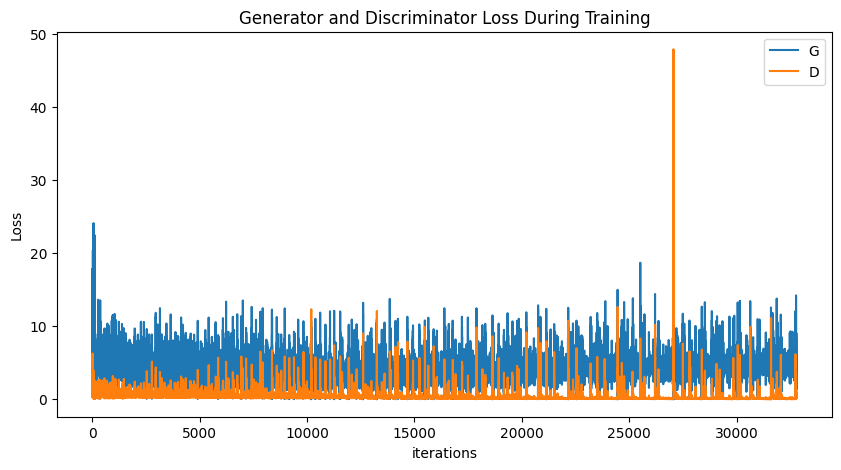

In [52]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21185686 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


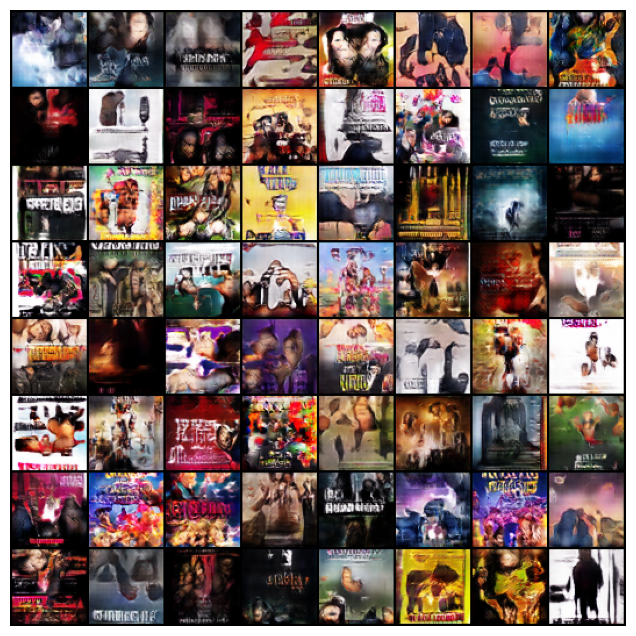

In [53]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

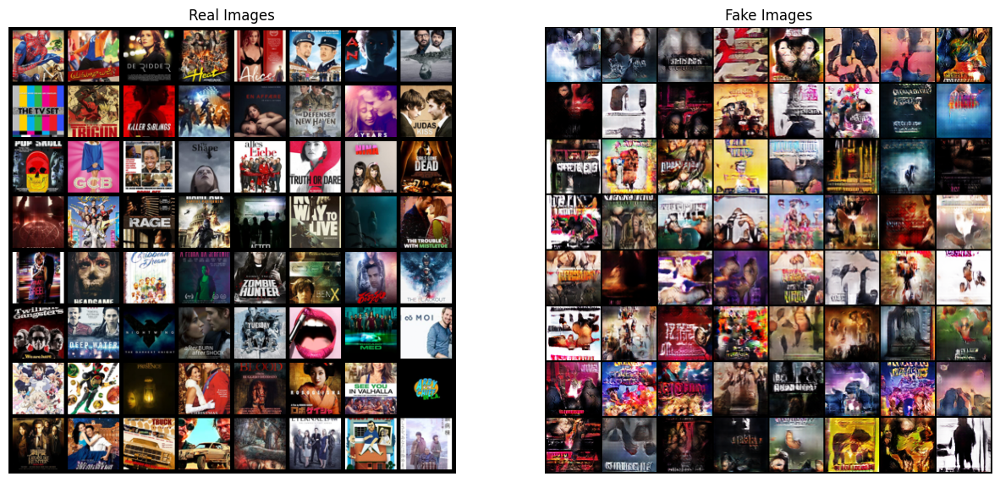

In [54]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(data_loader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

In [55]:
print(G_losses)

[6.547251224517822, 5.900437355041504, 7.330918788909912, 5.832976341247559, 8.059652328491211, 7.306451797485352, 8.854073524475098, 8.427295684814453, 10.276649475097656, 8.640668869018555, 12.16470718383789, 9.185688018798828, 13.939291000366211, 11.606866836547852, 9.668386459350586, 16.601778030395508, 13.595510482788086, 8.567831039428711, 17.82262420654297, 16.271230697631836, 7.225742340087891, 15.008042335510254, 14.75324821472168, 8.458783149719238, 17.35582733154297, 17.38176918029785, 10.60715103149414, 17.567602157592773, 16.083227157592773, 7.468605041503906, 16.807554244995117, 17.926414489746094, 12.389552116394043, 5.93358039855957, 18.43422508239746, 20.404293060302734, 16.485034942626953, 8.175786972045898, 17.75050926208496, 19.0653133392334, 13.780176162719727, 7.326346397399902, 20.21051025390625, 22.25107192993164, 18.052566528320312, 10.380702018737793, 6.662385940551758, 18.33572769165039, 20.116758346557617, 16.256242752075195, 8.303050994873047, 17.6468410491

In [56]:
print(D_losses)

[1.433274507522583, 1.012496829032898, 1.0191123485565186, 0.8300953507423401, 1.2134116888046265, 0.5682222843170166, 0.8909673690795898, 0.5963255763053894, 0.6953509449958801, 0.4384971857070923, 1.1759006977081299, 0.46142858266830444, 1.4301931858062744, 0.2933425307273865, 0.6314214468002319, 1.250130295753479, 0.6045796871185303, 0.4657731354236603, 3.5633277893066406, 0.7136906981468201, 0.3870466947555542, 6.2765398025512695, 0.6934851408004761, 0.4788493514060974, 3.048732042312622, 0.5046079158782959, 0.24757438898086548, 2.524907112121582, 0.8096938133239746, 0.36140328645706177, 5.9760870933532715, 0.3478321135044098, 0.48814141750335693, 0.3393634855747223, 3.806274175643921, 0.5278757214546204, 0.37909066677093506, 0.2636156380176544, 1.8958137035369873, 0.2964123487472534, 0.2739235758781433, 0.27766820788383484, 3.642209529876709, 0.39787915349006653, 0.4380204379558563, 0.255580872297287, 0.3901771903038025, 1.3061878681182861, 0.3770011365413666, 0.4461075961589813, 

In [57]:
# Save G_losses
np.savetxt("G_losses.txt", G_losses)

# Save D_losses
np.savetxt("D_losses.txt", D_losses)

In [60]:
from torchvision.utils import save_image

# Save generated images
print(len(img_list))
for i, img in enumerate(img_list):
    save_image(img, f"generated_images_{i}.png")

67


In [61]:
# Save generator and discriminator for later use
torch.save(netG.state_dict(), './generator.pth')
torch.save(netD.state_dict(), './discriminator.pth')